# 12 - SIFT + SfM Relative Pair Pose


## Ziel
Dieses Notebook testet **zwei Bilder relativ zueinander** mit:

- SIFT Keypoints + Descriptor Matching
- 2D Bewegungsschaetzung (Affine: Rotation, Translation, Scale)
- SfM-Relativpose (Essential Matrix: `R`, `t`-Richtung)
- Visualisierung in 2 Spalten pro Variante (a/b/c), aehnlich deinem Beispiel

Die Paar-IDs (`PAIR_ANCHOR_ID`, `PAIR_VAL_ID`) und Matching-Varianten sind direkt unten einstellbar.


In [1]:
from dataclasses import dataclass
from pathlib import Path
from typing import Dict, List, Optional, Tuple

import cv2
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from IPython.display import display


In [2]:
# Basic checks + paths
if not hasattr(cv2, 'SIFT_create'):
    raise RuntimeError('OpenCV build has no SIFT. Please install opencv-contrib-python.')

CANDIDATE_ROOTS = [Path.cwd(), Path.cwd().parent, Path('.'), Path('..')]
PROJECT_ROOT = None
_seen = set()
for cand in CANDIDATE_ROOTS:
    try:
        root = cand.resolve()
    except Exception:
        continue
    k = str(root)
    if k in _seen:
        continue
    _seen.add(k)
    if (root / 'data' / 'data').exists():
        PROJECT_ROOT = root
        break
if PROJECT_ROOT is None:
    raise FileNotFoundError('Could not find project root containing data/data.')

DATA_ROOT = PROJECT_ROOT / 'data' / 'data'
TRAIN_IMG_DIR = DATA_ROOT / 'train_data' / 'train_images'
TRAIN_POS_CSV = DATA_ROOT / 'train_data' / 'train_pos.csv'
TRAIN_CAM_CSV = DATA_ROOT / 'train_data' / 'train_cam.csv'

# Pair selection
PAIR_ANCHOR_ID = 13
PAIR_VAL_ID = 14
PREVIEW_PAIR_INDEX = 0

# Runtime + preprocessing
IMAGE_MAX_SIDE = 1400  # None for full resolution
PREPROCESS_MODE = 'gray_clahe'  # ['gray', 'gray_clahe', 'gray_denoise_clahe']

# Geometry thresholds
AFFINE_RANSAC_THR = 3.0
HOMOGRAPHY_RANSAC_THR = 4.0
ESSENTIAL_RANSAC_THR = 1.5

# Draw control
MAX_DRAW_MATCHES = 500

print('project_root:', PROJECT_ROOT)


project_root: /home/rupert/projects/gnss-denied-localization


In [3]:
# Load train table + consecutive pairs
train_pos_df = pd.read_csv(TRAIN_POS_CSV)
train_cam_df = pd.read_csv(TRAIN_CAM_CSV)
train_df = train_cam_df.merge(train_pos_df, on='id', how='inner').copy()
train_df['id'] = train_df['id'].astype(int)
train_df = train_df.sort_values('id').reset_index(drop=True)

required_cols = ['id', 'x_pixel', 'y_pixel', 'fx', 'fy', 'cx', 'cy']
for c in required_cols:
    if c not in train_df.columns:
        raise KeyError(f'Missing required column: {c}')

pairs = []
for i in range(len(train_df) - 1):
    r0 = train_df.iloc[i]
    r1 = train_df.iloc[i + 1]
    id0 = int(r0['id'])
    id1 = int(r1['id'])
    if id1 != id0 + 1:
        continue
    pairs.append({
        'pair_idx': len(pairs),
        'anchor_id': id0,
        'val_id': id1,
    })
pair_df = pd.DataFrame(pairs)

print('consecutive pairs:', len(pair_df))
display(pair_df.head(20))


consecutive pairs: 296


,pair_idx,anchor_id,val_id
0,0,13,14
1,1,14,15
2,2,15,16
3,3,16,17
4,4,17,18
5,5,18,19
6,6,19,20
7,7,20,21
8,8,21,22
9,9,22,23


In [4]:
# Utilities: image loading, preprocess, intrinsics
_IMAGE_CACHE: Dict[Tuple[int, Optional[int]], Tuple[np.ndarray, float]] = {}


def resolve_train_image_path(image_id: int) -> Path:
    stems = [f'{int(image_id):04d}', str(int(image_id))]
    exts = ['.JPG', '.jpg', '.jpeg', '.JPEG', '.png', '.PNG']
    for st in stems:
        for ext in exts:
            p = TRAIN_IMG_DIR / f'{st}{ext}'
            if p.exists():
                return p
    raise FileNotFoundError(f'Image not found for id={image_id} in {TRAIN_IMG_DIR}')


def load_train_image_cached(image_id: int, max_side: Optional[int]) -> Tuple[np.ndarray, float]:
    key = (int(image_id), max_side)
    if key in _IMAGE_CACHE:
        return _IMAGE_CACHE[key]

    p = resolve_train_image_path(int(image_id))
    bgr = cv2.imread(str(p), cv2.IMREAD_COLOR)
    if bgr is None:
        raise RuntimeError(f'Cannot read image: {p}')
    rgb = cv2.cvtColor(bgr, cv2.COLOR_BGR2RGB)

    scale = 1.0
    if max_side is not None:
        h, w = rgb.shape[:2]
        m = max(h, w)
        if m > int(max_side):
            scale = float(max_side) / float(m)
            nw = max(32, int(round(w * scale)))
            nh = max(32, int(round(h * scale)))
            rgb = cv2.resize(rgb, (nw, nh), interpolation=cv2.INTER_AREA)

    _IMAGE_CACHE[key] = (rgb, scale)
    return rgb, scale


def preprocess_for_sift(img_rgb: np.ndarray, mode: str = 'gray_clahe') -> np.ndarray:
    g = cv2.cvtColor(img_rgb, cv2.COLOR_RGB2GRAY)
    if mode == 'gray':
        return g
    if mode == 'gray_clahe':
        clahe = cv2.createCLAHE(clipLimit=2.5, tileGridSize=(8, 8))
        return clahe.apply(g)
    if mode == 'gray_denoise_clahe':
        g2 = cv2.bilateralFilter(g, d=7, sigmaColor=45, sigmaSpace=45)
        clahe = cv2.createCLAHE(clipLimit=2.5, tileGridSize=(8, 8))
        return clahe.apply(g2)
    raise KeyError(f'Unknown preprocess mode: {mode}')


def scaled_K(cam_row: pd.Series, image_scale: float) -> np.ndarray:
    fx = float(cam_row['fx']) * float(image_scale)
    fy = float(cam_row['fy']) * float(image_scale)
    cx = float(cam_row['cx']) * float(image_scale)
    cy = float(cam_row['cy']) * float(image_scale)
    return np.array([[fx, 0.0, cx], [0.0, fy, cy], [0.0, 0.0, 1.0]], dtype=np.float64)


def select_pair_row(pair_df: pd.DataFrame, anchor_id: int, val_id: int, fallback_idx: int = 0) -> pd.Series:
    sel = pair_df[
        (pair_df['anchor_id'].astype(int) == int(anchor_id)) &
        (pair_df['val_id'].astype(int) == int(val_id))
    ]
    if len(sel) > 0:
        return sel.iloc[0]
    idx = int(np.clip(fallback_idx, 0, len(pair_df) - 1))
    print(f'Pair {anchor_id}->{val_id} not found, fallback index {idx}.')
    return pair_df.iloc[idx]


pair: 13->14
img0: (1050, 1400, 3) scale0: 0.1749
img1: (1050, 1400, 3) scale1: 0.1749


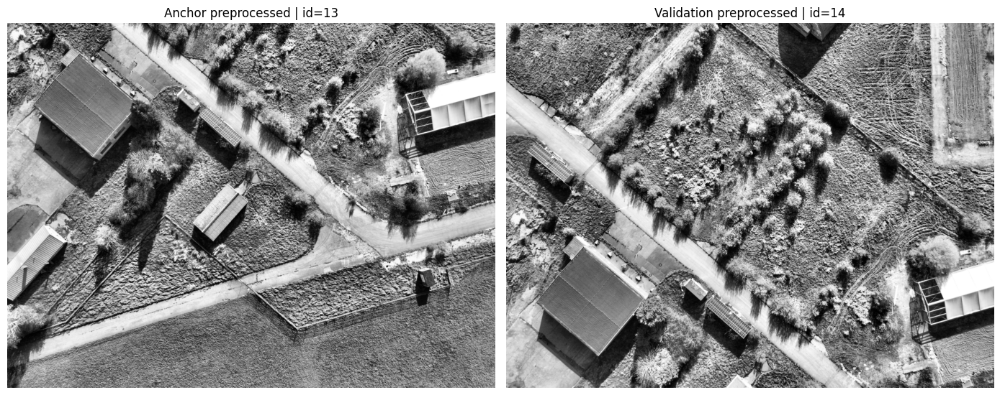

In [5]:
# Pair data preparation
pair_row = select_pair_row(pair_df, PAIR_ANCHOR_ID, PAIR_VAL_ID, PREVIEW_PAIR_INDEX)
anchor_id = int(pair_row['anchor_id'])
val_id = int(pair_row['val_id'])

r0 = train_df[train_df['id'].astype(int) == anchor_id].iloc[0]
r1 = train_df[train_df['id'].astype(int) == val_id].iloc[0]

img0_rgb, scale0 = load_train_image_cached(anchor_id, max_side=IMAGE_MAX_SIDE)
img1_rgb, scale1 = load_train_image_cached(val_id, max_side=IMAGE_MAX_SIDE)

gray0 = preprocess_for_sift(img0_rgb, mode=PREPROCESS_MODE)
gray1 = preprocess_for_sift(img1_rgb, mode=PREPROCESS_MODE)

K0 = scaled_K(r0, scale0)
K1 = scaled_K(r1, scale1)

print(f'pair: {anchor_id}->{val_id}')
print('img0:', img0_rgb.shape, 'scale0:', round(scale0, 4))
print('img1:', img1_rgb.shape, 'scale1:', round(scale1, 4))

fig, axes = plt.subplots(1, 2, figsize=(14, 6))
axes[0].imshow(gray0, cmap='gray')
axes[0].set_title(f'Anchor preprocessed | id={anchor_id}')
axes[0].axis('off')
axes[1].imshow(gray1, cmap='gray')
axes[1].set_title(f'Validation preprocessed | id={val_id}')
axes[1].axis('off')
plt.tight_layout()
plt.show()


In [6]:
# SIFT matching + geometry (Affine/Homography + SfM)
@dataclass
class PairMatchResult:
    name: str
    keypoints0: List[cv2.KeyPoint]
    keypoints1: List[cv2.KeyPoint]
    matches: List[cv2.DMatch]
    pts0: np.ndarray
    pts1: np.ndarray
    kp_size0: np.ndarray
    kp_size1: np.ndarray
    affine_M_1to0: Optional[np.ndarray]
    affine_inliers: np.ndarray
    affine_rotation_deg: float
    affine_tx: float
    affine_ty: float
    affine_scale: float
    affine_rmse: float
    H_1to0: Optional[np.ndarray]
    homography_inliers: np.ndarray
    sfm_R: Optional[np.ndarray]
    sfm_t: Optional[np.ndarray]
    sfm_inliers: np.ndarray
    sfm_rot_deg: float
    sfm_yaw_deg: float
    sfm_pitch_deg: float
    sfm_roll_deg: float


def rotation_matrix_to_euler_zyx(R: np.ndarray) -> Tuple[float, float, float]:
    sy = float(np.sqrt(R[0, 0] ** 2 + R[1, 0] ** 2))
    singular = sy < 1e-6

    if not singular:
        yaw = np.arctan2(R[1, 0], R[0, 0])
        pitch = np.arctan2(-R[2, 0], sy)
        roll = np.arctan2(R[2, 1], R[2, 2])
    else:
        yaw = np.arctan2(-R[0, 1], R[1, 1])
        pitch = np.arctan2(-R[2, 0], sy)
        roll = 0.0

    return float(np.degrees(yaw)), float(np.degrees(pitch)), float(np.degrees(roll))


def affine_transform_points(M: np.ndarray, pts: np.ndarray) -> np.ndarray:
    if pts.shape[0] == 0:
        return pts.copy()
    ones = np.ones((pts.shape[0], 1), dtype=np.float32)
    p = np.hstack([pts.astype(np.float32), ones])
    q = (M @ p.T).T
    return q.astype(np.float32)


def run_sift_sfm_variant(
    gray0: np.ndarray,
    gray1: np.ndarray,
    K0: np.ndarray,
    K1: np.ndarray,
    name: str,
    nfeatures: int,
    contrast_thr: float,
    edge_thr: float,
    sigma: float,
    ratio_thr: float,
    affine_thr: float,
    homography_thr: float,
    essential_thr: float,
) -> PairMatchResult:
    sift = cv2.SIFT_create(
        nfeatures=int(nfeatures),
        contrastThreshold=float(contrast_thr),
        edgeThreshold=float(edge_thr),
        sigma=float(sigma),
    )

    k0, d0 = sift.detectAndCompute(gray0, None)
    k1, d1 = sift.detectAndCompute(gray1, None)

    if d0 is None or d1 is None or len(k0) == 0 or len(k1) == 0:
        return PairMatchResult(
            name=name,
            keypoints0=k0 if k0 is not None else [],
            keypoints1=k1 if k1 is not None else [],
            matches=[],
            pts0=np.zeros((0, 2), np.float32),
            pts1=np.zeros((0, 2), np.float32),
            kp_size0=np.zeros((0,), np.float32),
            kp_size1=np.zeros((0,), np.float32),
            affine_M_1to0=None,
            affine_inliers=np.zeros((0,), bool),
            affine_rotation_deg=np.nan,
            affine_tx=np.nan,
            affine_ty=np.nan,
            affine_scale=np.nan,
            affine_rmse=np.nan,
            H_1to0=None,
            homography_inliers=np.zeros((0,), bool),
            sfm_R=None,
            sfm_t=None,
            sfm_inliers=np.zeros((0,), bool),
            sfm_rot_deg=np.nan,
            sfm_yaw_deg=np.nan,
            sfm_pitch_deg=np.nan,
            sfm_roll_deg=np.nan,
        )

    bf = cv2.BFMatcher(cv2.NORM_L2, crossCheck=False)
    knn = bf.knnMatch(d0, d1, k=2)

    good = []
    for pair in knn:
        if len(pair) < 2:
            continue
        m, n = pair
        if m.distance < float(ratio_thr) * n.distance:
            good.append(m)

    if len(good) == 0:
        return PairMatchResult(
            name=name,
            keypoints0=k0,
            keypoints1=k1,
            matches=[],
            pts0=np.zeros((0, 2), np.float32),
            pts1=np.zeros((0, 2), np.float32),
            kp_size0=np.zeros((0,), np.float32),
            kp_size1=np.zeros((0,), np.float32),
            affine_M_1to0=None,
            affine_inliers=np.zeros((0,), bool),
            affine_rotation_deg=np.nan,
            affine_tx=np.nan,
            affine_ty=np.nan,
            affine_scale=np.nan,
            affine_rmse=np.nan,
            H_1to0=None,
            homography_inliers=np.zeros((0,), bool),
            sfm_R=None,
            sfm_t=None,
            sfm_inliers=np.zeros((0,), bool),
            sfm_rot_deg=np.nan,
            sfm_yaw_deg=np.nan,
            sfm_pitch_deg=np.nan,
            sfm_roll_deg=np.nan,
        )

    pts0 = np.array([k0[m.queryIdx].pt for m in good], dtype=np.float32)
    pts1 = np.array([k1[m.trainIdx].pt for m in good], dtype=np.float32)
    s0 = np.array([k0[m.queryIdx].size for m in good], dtype=np.float32)
    s1 = np.array([k1[m.trainIdx].size for m in good], dtype=np.float32)

    # Affine 1->0 (for pixel rotation/translation/scale)
    if len(good) >= 3:
        M, inl_aff = cv2.estimateAffinePartial2D(
            pts1,
            pts0,
            method=cv2.RANSAC,
            ransacReprojThreshold=float(affine_thr),
            maxIters=20000,
            confidence=0.999,
            refineIters=50,
        )
    else:
        M, inl_aff = None, None

    if M is not None and inl_aff is not None:
        inl_aff = inl_aff.ravel().astype(bool)
        rot_deg = float(np.degrees(np.arctan2(M[1, 0], M[0, 0])))
        scale = float(np.sqrt(M[0, 0] ** 2 + M[1, 0] ** 2))
        tx = float(M[0, 2])
        ty = float(M[1, 2])

        p1w = affine_transform_points(M, pts1)
        if np.any(inl_aff):
            err = np.linalg.norm(pts0[inl_aff] - p1w[inl_aff], axis=1)
            rmse = float(np.sqrt(np.mean(err ** 2)))
        else:
            rmse = np.nan
    else:
        inl_aff = np.zeros((len(good),), dtype=bool)
        rot_deg = np.nan
        scale = np.nan
        tx = np.nan
        ty = np.nan
        rmse = np.nan

    # Homography 1->0 (optional, diagnostics)
    if len(good) >= 4:
        H, inl_h = cv2.findHomography(
            pts1,
            pts0,
            method=cv2.USAC_MAGSAC,
            ransacReprojThreshold=float(homography_thr),
            maxIters=20000,
            confidence=0.999,
        )
    else:
        H, inl_h = None, None

    if H is not None and inl_h is not None:
        inl_h = inl_h.ravel().astype(bool)
    else:
        H = None
        inl_h = np.zeros((len(good),), dtype=bool)

    # SfM relative pose from normalized points
    sfm_R = None
    sfm_t = None
    sfm_inl = np.zeros((len(good),), dtype=bool)
    sfm_rot = np.nan
    sfm_yaw = np.nan
    sfm_pitch = np.nan
    sfm_roll = np.nan

    if len(good) >= 8:
        pts0n = cv2.undistortPoints(pts0.reshape(-1, 1, 2), K0, None).reshape(-1, 2)
        pts1n = cv2.undistortPoints(pts1.reshape(-1, 1, 2), K1, None).reshape(-1, 2)

        E, inl_e = cv2.findEssentialMat(
            pts0n,
            pts1n,
            cameraMatrix=np.eye(3),
            method=cv2.RANSAC,
            prob=0.999,
            threshold=float(essential_thr),
        )

        if E is not None and inl_e is not None:
            inl_e = inl_e.ravel().astype(bool)
            if np.count_nonzero(inl_e) >= 8:
                _, R, t, inl_pose = cv2.recoverPose(
                    E,
                    pts0n,
                    pts1n,
                    cameraMatrix=np.eye(3),
                    mask=inl_e.astype(np.uint8).reshape(-1, 1),
                )
                sfm_R = R
                sfm_t = t.reshape(3)
                if inl_pose is not None:
                    sfm_inl = inl_pose.ravel().astype(bool)
                else:
                    sfm_inl = inl_e.copy()

                rvec, _ = cv2.Rodrigues(R)
                sfm_rot = float(np.linalg.norm(rvec) * 180.0 / np.pi)
                sfm_yaw, sfm_pitch, sfm_roll = rotation_matrix_to_euler_zyx(R)

    return PairMatchResult(
        name=name,
        keypoints0=k0,
        keypoints1=k1,
        matches=good,
        pts0=pts0,
        pts1=pts1,
        kp_size0=s0,
        kp_size1=s1,
        affine_M_1to0=M,
        affine_inliers=inl_aff,
        affine_rotation_deg=rot_deg,
        affine_tx=tx,
        affine_ty=ty,
        affine_scale=scale,
        affine_rmse=rmse,
        H_1to0=H,
        homography_inliers=inl_h,
        sfm_R=sfm_R,
        sfm_t=sfm_t,
        sfm_inliers=sfm_inl,
        sfm_rot_deg=sfm_rot,
        sfm_yaw_deg=sfm_yaw,
        sfm_pitch_deg=sfm_pitch,
        sfm_roll_deg=sfm_roll,
    )


In [7]:
# Variant grid (a/b/c) and run
VARIANTS = [
    {
        'name': 'a_strict',
        'nfeatures': 6000,
        'contrast_thr': 0.04,
        'edge_thr': 10,
        'sigma': 1.6,
        'ratio_thr': 0.70,
    },
    {
        'name': 'b_balanced',
        'nfeatures': 9000,
        'contrast_thr': 0.03,
        'edge_thr': 12,
        'sigma': 1.6,
        'ratio_thr': 0.78,
    },
    {
        'name': 'c_loose',
        'nfeatures': 12000,
        'contrast_thr': 0.02,
        'edge_thr': 14,
        'sigma': 1.6,
        'ratio_thr': 0.86,
    },
]

results: List[PairMatchResult] = []
for v in VARIANTS:
    out = run_sift_sfm_variant(
        gray0=gray0,
        gray1=gray1,
        K0=K0,
        K1=K1,
        name=v['name'],
        nfeatures=v['nfeatures'],
        contrast_thr=v['contrast_thr'],
        edge_thr=v['edge_thr'],
        sigma=v['sigma'],
        ratio_thr=v['ratio_thr'],
        affine_thr=AFFINE_RANSAC_THR,
        homography_thr=HOMOGRAPHY_RANSAC_THR,
        essential_thr=ESSENTIAL_RANSAC_THR,
    )
    results.append(out)

print('Finished variants:', [r.name for r in results])


Finished variants: ['a_strict', 'b_balanced', 'c_loose']


In [8]:
# Visualization helpers

def to_rgb(gray: np.ndarray) -> np.ndarray:
    if gray.ndim == 2:
        return cv2.cvtColor(gray, cv2.COLOR_GRAY2RGB)
    return gray.copy()


def clip_pt(p: np.ndarray, w: int, h: int) -> Tuple[int, int]:
    x = int(np.clip(round(float(p[0])), 0, w - 1))
    y = int(np.clip(round(float(p[1])), 0, h - 1))
    return x, y


def draw_variant_pair(
    gray0: np.ndarray,
    gray1: np.ndarray,
    res: PairMatchResult,
    max_draw: int = 500,
) -> Tuple[np.ndarray, np.ndarray]:
    h0, w0 = gray0.shape[:2]

    left = to_rgb(gray0)

    if res.affine_M_1to0 is not None:
        warped1 = cv2.warpAffine(gray1, res.affine_M_1to0, (w0, h0), flags=cv2.INTER_LINEAR, borderValue=0)
        p1w = affine_transform_points(res.affine_M_1to0, res.pts1)
    else:
        warped1 = cv2.resize(gray1, (w0, h0), interpolation=cv2.INTER_LINEAR)
        p1w = np.zeros_like(res.pts1)

    right = cv2.addWeighted(to_rgb(gray0), 0.45, to_rgb(warped1), 0.55, 0.0)

    n = len(res.matches)
    if n == 0:
        return left, right

    draw_idx = np.arange(n, dtype=np.int32)
    inl = res.affine_inliers if res.affine_inliers.shape[0] == n else np.zeros((n,), dtype=bool)

    # prioritize inliers
    if draw_idx.size > max_draw:
        inl_idx = np.where(inl)[0]
        out_idx = np.where(~inl)[0]
        if inl_idx.size >= max_draw:
            draw_idx = inl_idx[:max_draw]
        else:
            rem = max_draw - inl_idx.size
            draw_idx = np.concatenate([inl_idx, out_idx[:rem]])

    for i in draw_idx:
        ok = bool(inl[i])
        col = (0, 255, 0) if ok else (255, 0, 0)

        p0 = res.pts0[i]
        x0, y0 = clip_pt(p0, w0, h0)
        r0 = int(max(2, round(float(res.kp_size0[i]) * 0.35)))
        cv2.circle(left, (x0, y0), r0, col, 1, cv2.LINE_AA)
        cv2.circle(left, (x0, y0), 1, (255, 255, 0), -1, cv2.LINE_AA)

        if res.affine_M_1to0 is not None:
            p1 = p1w[i]
            x1, y1 = clip_pt(p1, w0, h0)
            r1 = int(max(2, round(float(res.kp_size1[i]) * 0.35)))
            cv2.circle(right, (x1, y1), r1, col, 1, cv2.LINE_AA)
            cv2.circle(right, (x1, y1), 1, (255, 255, 0), -1, cv2.LINE_AA)

            # residual line in anchor frame (for inliers only)
            if ok:
                cv2.line(left, (x0, y0), (x1, y1), (0, 255, 255), 1, cv2.LINE_AA)

    return left, right


def summarize_result(res: PairMatchResult) -> Dict[str, object]:
    sfm_tx, sfm_ty, sfm_tz = (np.nan, np.nan, np.nan)
    if res.sfm_t is not None:
        t = res.sfm_t.astype(float)
        n = float(np.linalg.norm(t))
        if n > 1e-12:
            t = t / n
        sfm_tx, sfm_ty, sfm_tz = float(t[0]), float(t[1]), float(t[2])

    return {
        'variant': res.name,
        'kp0': len(res.keypoints0),
        'kp1': len(res.keypoints1),
        'matches_ratio': len(res.matches),
        'affine_inliers': int(res.affine_inliers.sum()) if res.affine_inliers.size else 0,
        'homography_inliers': int(res.homography_inliers.sum()) if res.homography_inliers.size else 0,
        'affine_rot_deg': res.affine_rotation_deg,
        'affine_tx_px': res.affine_tx,
        'affine_ty_px': res.affine_ty,
        'affine_scale': res.affine_scale,
        'affine_rmse_px': res.affine_rmse,
        'sfm_inliers': int(res.sfm_inliers.sum()) if res.sfm_inliers.size else 0,
        'sfm_rot_deg': res.sfm_rot_deg,
        'sfm_yaw_deg': res.sfm_yaw_deg,
        'sfm_pitch_deg': res.sfm_pitch_deg,
        'sfm_roll_deg': res.sfm_roll_deg,
        'sfm_t_dir_x': sfm_tx,
        'sfm_t_dir_y': sfm_ty,
        'sfm_t_dir_z': sfm_tz,
    }


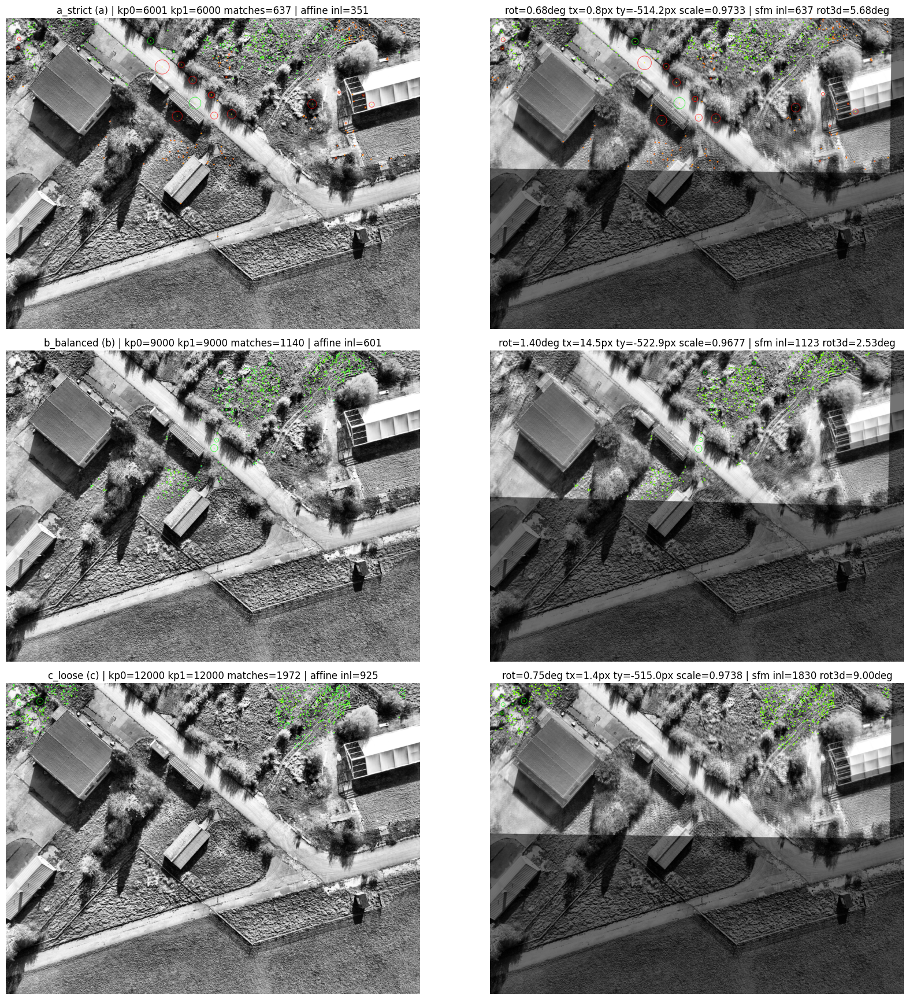

In [9]:
# Plot 2-column panel (a/b/c) similar to reference figure
if len(results) == 0:
    raise RuntimeError('No results available. Run variant cell first.')

fig, axes = plt.subplots(len(results), 2, figsize=(18, 5.8 * len(results)))
if len(results) == 1:
    axes = np.array([axes])

row_tags = ['(a)', '(b)', '(c)', '(d)', '(e)']

for r, res in enumerate(results):
    left, right = draw_variant_pair(gray0, gray1, res, max_draw=MAX_DRAW_MATCHES)

    axes[r, 0].imshow(left)
    axes[r, 0].axis('off')
    axes[r, 1].imshow(right)
    axes[r, 1].axis('off')

    tag = row_tags[r] if r < len(row_tags) else f'({r+1})'
    inl_a = int(res.affine_inliers.sum()) if res.affine_inliers.size else 0
    inl_s = int(res.sfm_inliers.sum()) if res.sfm_inliers.size else 0

    axes[r, 0].set_title(
        f"{res.name} {tag} | kp0={len(res.keypoints0)} kp1={len(res.keypoints1)} "
        f"matches={len(res.matches)} | affine inl={inl_a}"
    )
    axes[r, 1].set_title(
        f"rot={res.affine_rotation_deg:.2f}deg tx={res.affine_tx:.1f}px ty={res.affine_ty:.1f}px "
        f"scale={res.affine_scale:.4f} | sfm inl={inl_s} rot3d={res.sfm_rot_deg:.2f}deg"
    )

plt.tight_layout()
plt.show()


In [10]:
# Metrics table + best variant selection
rows = [summarize_result(r) for r in results]
metrics_df = pd.DataFrame(rows)
metrics_df = metrics_df.sort_values(['affine_inliers', 'matches_ratio'], ascending=False).reset_index(drop=True)
display(metrics_df)

best = metrics_df.iloc[0]
print('Best by affine inliers:', best['variant'])
print(
    f"2D relative pose (pixel frame): rot={best['affine_rot_deg']:.2f} deg, "
    f"tx={best['affine_tx_px']:.2f} px, ty={best['affine_ty_px']:.2f} px, scale={best['affine_scale']:.4f}"
)
print(
    f"SfM orientation approx: yaw={best['sfm_yaw_deg']:.2f}, "
    f"pitch={best['sfm_pitch_deg']:.2f}, roll={best['sfm_roll_deg']:.2f} deg"
)
print(
    f"SfM translation direction (unit): "
    f"[{best['sfm_t_dir_x']:.3f}, {best['sfm_t_dir_y']:.3f}, {best['sfm_t_dir_z']:.3f}]"
)


,variant,kp0,kp1,matches_ratio,affine_inliers,homography_inliers,affine_rot_deg,affine_tx_px,affine_ty_px,affine_scale,affine_rmse_px,sfm_inliers,sfm_rot_deg,sfm_yaw_deg,sfm_pitch_deg,sfm_roll_deg,sfm_t_dir_x,sfm_t_dir_y,sfm_t_dir_z
0,c_loose,12000,12000,1972,925,1613,0.750918,1.350959,-514.956358,0.973819,1.666168,1830,9.002362,-3.138729,3.957464,7.346802,-0.027381,0.996178,0.082939
1,b_balanced,9000,9000,1140,601,1063,1.397201,14.475165,-522.940544,0.967735,1.609817,1123,2.533431,-0.379881,1.685048,-1.858929,-0.006868,0.998954,-0.045203
2,a_strict,6001,6000,637,351,609,0.676863,0.762324,-514.178610,0.973338,1.519596,637,5.677967,-1.986679,-0.101263,5.320121,0.075221,0.996553,0.034980


Best by affine inliers: c_loose
2D relative pose (pixel frame): rot=0.75 deg, tx=1.35 px, ty=-514.96 px, scale=0.9738
SfM orientation approx: yaw=-3.14, pitch=3.96, roll=7.35 deg
SfM translation direction (unit): [-0.027, 0.996, 0.083]


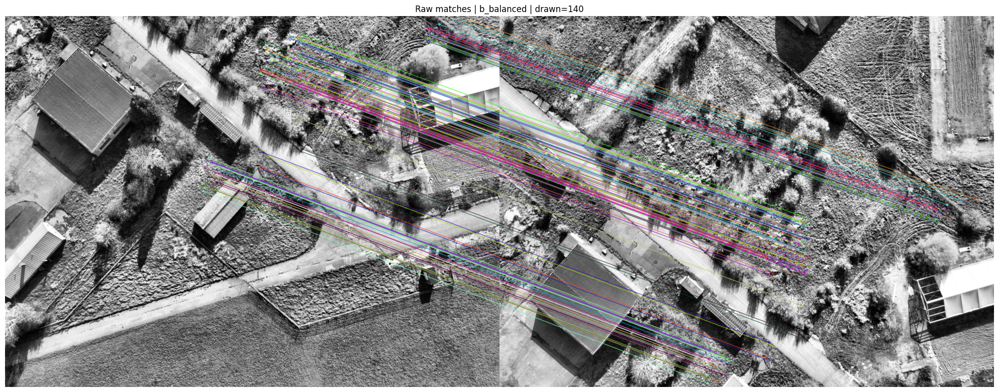

In [11]:
# Optional: visualize raw match lines for selected variant (similar to notebook 1 style)
SELECT_VARIANT = 'b_balanced'
MAX_LINE_MATCHES = 140

cand = [r for r in results if r.name == SELECT_VARIANT]
if len(cand) == 0:
    sel_res = results[0]
    print(f'Variant {SELECT_VARIANT} not found. Using {sel_res.name}.')
else:
    sel_res = cand[0]

show_idx = np.arange(len(sel_res.matches), dtype=np.int32)
inl = sel_res.affine_inliers if sel_res.affine_inliers.shape[0] == len(sel_res.matches) else np.zeros((len(sel_res.matches),), bool)
if show_idx.size > MAX_LINE_MATCHES:
    # prioritize inliers first
    inl_idx = np.where(inl)[0]
    out_idx = np.where(~inl)[0]
    need = int(MAX_LINE_MATCHES)
    if inl_idx.size >= need:
        show_idx = inl_idx[:need]
    else:
        show_idx = np.concatenate([inl_idx, out_idx[:need - inl_idx.size]])

vis0 = cv2.cvtColor(gray0, cv2.COLOR_GRAY2BGR)
vis1 = cv2.cvtColor(gray1, cv2.COLOR_GRAY2BGR)

draw_matches = [sel_res.matches[int(i)] for i in show_idx]
match_img = cv2.drawMatches(
    vis0,
    sel_res.keypoints0,
    vis1,
    sel_res.keypoints1,
    draw_matches,
    None,
    flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS,
)

plt.figure(figsize=(20, 8))
plt.imshow(cv2.cvtColor(match_img, cv2.COLOR_BGR2RGB))
plt.title(f"Raw matches | {sel_res.name} | drawn={len(draw_matches)}")
plt.axis('off')
plt.tight_layout()
plt.show()


## Feature Focus Sweep (Less Grass, More Building Edges/Corners)
Dieser Zusatzblock erweitert Notebook 12 um testbare Einstellungen, die **Gras-Textur unterdrücken** und stärker auf **Ecken/Kanten** (Gebäude, Straßenkanten, lineare Strukturen) fokussieren.

Enthalten:
- Mask-Profile: `none`, `nongreen`, `edge_corner_mild`, `edge_corner_strict`, `line_corner_only`
- SIFT-Match-Filter: `mutual_check`, `kp_response_min`, `size_ratio_min/max`
- Vergleichsmetriken inkl. **Gras-Anteil** der Matches


In [12]:
# Enhanced mask + matching helpers (grass suppression / edge-corner focus)
from dataclasses import dataclass
from typing import Dict, Optional


def _ensure_gray_u8(gray: np.ndarray) -> np.ndarray:
    if gray.dtype == np.uint8:
        return gray
    return np.clip(gray, 0, 255).astype(np.uint8)


def compute_green_mask(img_rgb: np.ndarray, h_low: int = 30, h_high: int = 100, s_min: int = 35, v_min: int = 25) -> np.ndarray:
    hsv = cv2.cvtColor(img_rgb, cv2.COLOR_RGB2HSV)
    lo = np.array([int(h_low), int(s_min), int(v_min)], dtype=np.uint8)
    hi = np.array([int(h_high), 255, 255], dtype=np.uint8)
    return cv2.inRange(hsv, lo, hi)


def _draw_hough_line_mask(
    edges: np.ndarray,
    threshold: int,
    min_line_len: int,
    max_line_gap: int,
    thickness: int,
) -> np.ndarray:
    line_mask = np.zeros_like(edges, dtype=np.uint8)
    lines = cv2.HoughLinesP(
        edges,
        rho=1,
        theta=np.pi / 180.0,
        threshold=int(threshold),
        minLineLength=int(min_line_len),
        maxLineGap=int(max_line_gap),
    )
    if lines is not None:
        for ln in lines:
            x1, y1, x2, y2 = ln[0]
            cv2.line(line_mask, (int(x1), int(y1)), (int(x2), int(y2)), 255, int(thickness), cv2.LINE_AA)
    return line_mask


def _draw_corner_mask(
    gray_u8: np.ndarray,
    max_corners: int,
    quality: float,
    min_dist: float,
    radius: int,
) -> np.ndarray:
    corner_mask = np.zeros_like(gray_u8, dtype=np.uint8)
    corners = cv2.goodFeaturesToTrack(
        gray_u8,
        maxCorners=int(max_corners),
        qualityLevel=float(quality),
        minDistance=float(min_dist),
        useHarrisDetector=False,
    )
    if corners is not None:
        for c in corners.reshape(-1, 2):
            x = int(round(float(c[0])))
            y = int(round(float(c[1])))
            cv2.circle(corner_mask, (x, y), int(radius), 255, -1, cv2.LINE_AA)
    return corner_mask


def build_feature_focus_mask(
    img_rgb: np.ndarray,
    gray: np.ndarray,
    profile: str,
    params: Optional[Dict[str, float]] = None,
) -> Tuple[np.ndarray, Dict[str, float], np.ndarray]:
    # returns: mask_u8 (255 keep / 0 suppress), diagnostics dict, green_mask_u8
    p = dict(params or {})
    gray_u8 = _ensure_gray_u8(gray)

    full = np.full_like(gray_u8, 255, dtype=np.uint8)
    green = compute_green_mask(
        img_rgb,
        h_low=int(p.get('green_h_low', 30)),
        h_high=int(p.get('green_h_high', 100)),
        s_min=int(p.get('green_s_min', 35)),
        v_min=int(p.get('green_v_min', 25)),
    )
    nongreen = cv2.bitwise_not(green)

    k_open = int(max(1, p.get('nongreen_open', 3)))
    k_close = int(max(1, p.get('nongreen_close', 5)))
    ker_open = np.ones((k_open, k_open), np.uint8)
    ker_close = np.ones((k_close, k_close), np.uint8)
    nongreen = cv2.morphologyEx(nongreen, cv2.MORPH_OPEN, ker_open)
    nongreen = cv2.morphologyEx(nongreen, cv2.MORPH_CLOSE, ker_close)

    canny_low = int(p.get('canny_low', 70))
    canny_high = int(p.get('canny_high', 170))
    edges = cv2.Canny(gray_u8, canny_low, canny_high)

    edge_dilate = int(max(1, p.get('edge_dilate', 2)))
    if edge_dilate > 1:
        edges = cv2.dilate(edges, np.ones((edge_dilate, edge_dilate), np.uint8), iterations=1)

    line_mask = _draw_hough_line_mask(
        edges=edges,
        threshold=int(p.get('line_threshold', 65)),
        min_line_len=int(p.get('line_min_len', 60)),
        max_line_gap=int(p.get('line_max_gap', 8)),
        thickness=int(p.get('line_thickness', 2)),
    )

    corner_mask = _draw_corner_mask(
        gray_u8=gray_u8,
        max_corners=int(p.get('corner_max', 1200)),
        quality=float(p.get('corner_quality', 0.010)),
        min_dist=float(p.get('corner_min_dist', 6.0)),
        radius=int(p.get('corner_radius', 2)),
    )

    line_dilate = int(max(1, p.get('line_dilate', 2)))
    corner_dilate = int(max(1, p.get('corner_dilate', 2)))
    if line_dilate > 1:
        line_mask = cv2.dilate(line_mask, np.ones((line_dilate, line_dilate), np.uint8), iterations=1)
    if corner_dilate > 1:
        corner_mask = cv2.dilate(corner_mask, np.ones((corner_dilate, corner_dilate), np.uint8), iterations=1)

    structure = cv2.bitwise_or(edges, line_mask)
    structure = cv2.bitwise_or(structure, corner_mask)

    profile = str(profile).strip().lower()
    if profile == 'none':
        mask = full
    elif profile == 'nongreen':
        mask = nongreen
    elif profile == 'edge_corner_mild':
        # Keep non-green structural regions, but preserve strong lines/corners explicitly.
        mask = cv2.bitwise_and(nongreen, cv2.dilate(structure, np.ones((3, 3), np.uint8), iterations=1))
        mask = cv2.bitwise_or(mask, line_mask)
        mask = cv2.bitwise_or(mask, corner_mask)
    elif profile == 'edge_corner_strict':
        # Strong grass suppression and structure gating.
        mask = cv2.bitwise_and(nongreen, structure)
        mask = cv2.bitwise_or(mask, cv2.bitwise_and(line_mask, nongreen))
        mask = cv2.bitwise_or(mask, cv2.bitwise_and(corner_mask, nongreen))
        mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, np.ones((3, 3), np.uint8))
    elif profile == 'line_corner_only':
        mask = cv2.bitwise_or(line_mask, corner_mask)
    else:
        raise KeyError(f'Unknown mask profile: {profile}')

    final_close = int(max(1, p.get('final_close', 3)))
    if final_close > 1:
        mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, np.ones((final_close, final_close), np.uint8))

    min_cov = float(p.get('min_coverage', 0.03))
    cov = float((mask > 0).mean())
    fallback = 0.0
    if cov < min_cov:
        # fallback: nongreen to avoid too few features
        mask = nongreen.copy()
        cov = float((mask > 0).mean())
        fallback = 1.0

    diag = {
        'mask_cov': cov,
        'green_cov': float((green > 0).mean()),
        'edge_cov': float((edges > 0).mean()),
        'line_cov': float((line_mask > 0).mean()),
        'corner_cov': float((corner_mask > 0).mean()),
        'fallback': fallback,
    }
    return mask.astype(np.uint8), diag, green.astype(np.uint8)


def _pts_in_mask(mask_u8: np.ndarray, pts: np.ndarray) -> np.ndarray:
    if pts.shape[0] == 0:
        return np.zeros((0,), dtype=bool)
    h, w = mask_u8.shape[:2]
    out = np.zeros((pts.shape[0],), dtype=bool)
    for i, p in enumerate(pts):
        x = int(np.clip(round(float(p[0])), 0, w - 1))
        y = int(np.clip(round(float(p[1])), 0, h - 1))
        out[i] = bool(mask_u8[y, x] > 0)
    return out


def _kp_green_fraction(kps: List[cv2.KeyPoint], green_mask_u8: np.ndarray) -> float:
    if len(kps) == 0:
        return np.nan
    h, w = green_mask_u8.shape[:2]
    c = 0
    for kp in kps:
        x = int(np.clip(round(float(kp.pt[0])), 0, w - 1))
        y = int(np.clip(round(float(kp.pt[1])), 0, h - 1))
        if green_mask_u8[y, x] > 0:
            c += 1
    return 100.0 * float(c) / float(len(kps))


@dataclass
class FocusedMatchResult:
    name: str
    preprocess_mode: str
    mask_profile: str
    gray0: np.ndarray
    gray1: np.ndarray
    mask0: np.ndarray
    mask1: np.ndarray
    green0: np.ndarray
    green1: np.ndarray
    mask_diag0: Dict[str, float]
    mask_diag1: Dict[str, float]
    keypoints0: List[cv2.KeyPoint]
    keypoints1: List[cv2.KeyPoint]
    matches: List[cv2.DMatch]
    pts0: np.ndarray
    pts1: np.ndarray
    kp_size0: np.ndarray
    kp_size1: np.ndarray
    affine_M_1to0: Optional[np.ndarray]
    affine_inliers: np.ndarray
    affine_rotation_deg: float
    affine_tx: float
    affine_ty: float
    affine_scale: float
    affine_rmse: float
    H_1to0: Optional[np.ndarray]
    homography_inliers: np.ndarray
    sfm_R: Optional[np.ndarray]
    sfm_t: Optional[np.ndarray]
    sfm_inliers: np.ndarray
    sfm_rot_deg: float
    sfm_yaw_deg: float
    sfm_pitch_deg: float
    sfm_roll_deg: float
    dropped_by_response: int
    dropped_by_size_ratio: int


def _make_empty_focused_result(
    name: str,
    preprocess_mode: str,
    mask_profile: str,
    gray0: np.ndarray,
    gray1: np.ndarray,
    mask0: np.ndarray,
    mask1: np.ndarray,
    green0: np.ndarray,
    green1: np.ndarray,
    diag0: Dict[str, float],
    diag1: Dict[str, float],
    keypoints0: Optional[List[cv2.KeyPoint]] = None,
    keypoints1: Optional[List[cv2.KeyPoint]] = None,
) -> FocusedMatchResult:
    return FocusedMatchResult(
        name=name,
        preprocess_mode=preprocess_mode,
        mask_profile=mask_profile,
        gray0=gray0,
        gray1=gray1,
        mask0=mask0,
        mask1=mask1,
        green0=green0,
        green1=green1,
        mask_diag0=diag0,
        mask_diag1=diag1,
        keypoints0=keypoints0 if keypoints0 is not None else [],
        keypoints1=keypoints1 if keypoints1 is not None else [],
        matches=[],
        pts0=np.zeros((0, 2), np.float32),
        pts1=np.zeros((0, 2), np.float32),
        kp_size0=np.zeros((0,), np.float32),
        kp_size1=np.zeros((0,), np.float32),
        affine_M_1to0=None,
        affine_inliers=np.zeros((0,), bool),
        affine_rotation_deg=np.nan,
        affine_tx=np.nan,
        affine_ty=np.nan,
        affine_scale=np.nan,
        affine_rmse=np.nan,
        H_1to0=None,
        homography_inliers=np.zeros((0,), bool),
        sfm_R=None,
        sfm_t=None,
        sfm_inliers=np.zeros((0,), bool),
        sfm_rot_deg=np.nan,
        sfm_yaw_deg=np.nan,
        sfm_pitch_deg=np.nan,
        sfm_roll_deg=np.nan,
        dropped_by_response=0,
        dropped_by_size_ratio=0,
    )


def run_focused_sift_variant(
    img0_rgb: np.ndarray,
    img1_rgb: np.ndarray,
    K0: np.ndarray,
    K1: np.ndarray,
    name: str,
    preprocess_mode: str,
    mask_profile: str,
    nfeatures: int,
    contrast_thr: float,
    edge_thr: float,
    sigma: float,
    ratio_thr: float,
    affine_thr: float,
    homography_thr: float,
    essential_thr: float,
    mutual_check: bool,
    kp_response_min: float,
    size_ratio_min: float,
    size_ratio_max: float,
    mask_params: Optional[Dict[str, float]] = None,
) -> FocusedMatchResult:
    gray0 = preprocess_for_sift(img0_rgb, mode=preprocess_mode)
    gray1 = preprocess_for_sift(img1_rgb, mode=preprocess_mode)

    mask0, diag0, green0 = build_feature_focus_mask(img0_rgb, gray0, profile=mask_profile, params=mask_params)
    mask1, diag1, green1 = build_feature_focus_mask(img1_rgb, gray1, profile=mask_profile, params=mask_params)

    sift = cv2.SIFT_create(
        nfeatures=int(nfeatures),
        contrastThreshold=float(contrast_thr),
        edgeThreshold=float(edge_thr),
        sigma=float(sigma),
    )

    k0, d0 = sift.detectAndCompute(gray0, mask0)
    k1, d1 = sift.detectAndCompute(gray1, mask1)

    if d0 is None or d1 is None or len(k0) == 0 or len(k1) == 0:
        return _make_empty_focused_result(name, preprocess_mode, mask_profile, gray0, gray1, mask0, mask1, green0, green1, diag0, diag1, k0 or [], k1 or [])

    bf = cv2.BFMatcher(cv2.NORM_L2, crossCheck=False)
    knn01 = bf.knnMatch(d0, d1, k=2)

    ratio_good: List[cv2.DMatch] = []
    for pair in knn01:
        if len(pair) < 2:
            continue
        m, n = pair
        if m.distance < float(ratio_thr) * n.distance:
            ratio_good.append(m)

    if len(ratio_good) == 0:
        return _make_empty_focused_result(name, preprocess_mode, mask_profile, gray0, gray1, mask0, mask1, green0, green1, diag0, diag1, k0, k1)

    candidates = ratio_good
    if bool(mutual_check):
        knn10 = bf.knnMatch(d1, d0, k=1)
        best10: Dict[int, int] = {}
        for pair in knn10:
            if len(pair) < 1:
                continue
            m = pair[0]
            best10[int(m.queryIdx)] = int(m.trainIdx)
        candidates = [m for m in candidates if best10.get(int(m.trainIdx), -1) == int(m.queryIdx)]

    if len(candidates) == 0:
        return _make_empty_focused_result(name, preprocess_mode, mask_profile, gray0, gray1, mask0, mask1, green0, green1, diag0, diag1, k0, k1)

    good: List[cv2.DMatch] = []
    dropped_resp = 0
    dropped_size = 0
    size_ratio_min = float(size_ratio_min)
    size_ratio_max = float(size_ratio_max)
    kp_response_min = float(kp_response_min)

    for m in candidates:
        r0 = float(k0[m.queryIdx].response)
        r1 = float(k1[m.trainIdx].response)
        if min(r0, r1) < kp_response_min:
            dropped_resp += 1
            continue

        s0 = float(k0[m.queryIdx].size)
        s1 = float(k1[m.trainIdx].size)
        sr = (s1 + 1e-6) / (s0 + 1e-6)
        if sr < size_ratio_min or sr > size_ratio_max:
            dropped_size += 1
            continue

        good.append(m)

    if len(good) == 0:
        out = _make_empty_focused_result(name, preprocess_mode, mask_profile, gray0, gray1, mask0, mask1, green0, green1, diag0, diag1, k0, k1)
        out.dropped_by_response = int(dropped_resp)
        out.dropped_by_size_ratio = int(dropped_size)
        return out

    pts0 = np.array([k0[m.queryIdx].pt for m in good], dtype=np.float32)
    pts1 = np.array([k1[m.trainIdx].pt for m in good], dtype=np.float32)
    s0 = np.array([k0[m.queryIdx].size for m in good], dtype=np.float32)
    s1 = np.array([k1[m.trainIdx].size for m in good], dtype=np.float32)

    if len(good) >= 3:
        M, inl_aff = cv2.estimateAffinePartial2D(
            pts1,
            pts0,
            method=cv2.RANSAC,
            ransacReprojThreshold=float(affine_thr),
            maxIters=20000,
            confidence=0.999,
            refineIters=50,
        )
    else:
        M, inl_aff = None, None

    if M is not None and inl_aff is not None:
        inl_aff = inl_aff.ravel().astype(bool)
        rot_deg = float(np.degrees(np.arctan2(M[1, 0], M[0, 0])))
        scale = float(np.sqrt(M[0, 0] ** 2 + M[1, 0] ** 2))
        tx = float(M[0, 2])
        ty = float(M[1, 2])

        p1w = affine_transform_points(M, pts1)
        if np.any(inl_aff):
            err = np.linalg.norm(pts0[inl_aff] - p1w[inl_aff], axis=1)
            rmse = float(np.sqrt(np.mean(err ** 2)))
        else:
            rmse = np.nan
    else:
        inl_aff = np.zeros((len(good),), dtype=bool)
        rot_deg = np.nan
        scale = np.nan
        tx = np.nan
        ty = np.nan
        rmse = np.nan

    if len(good) >= 4:
        H, inl_h = cv2.findHomography(
            pts1,
            pts0,
            method=cv2.USAC_MAGSAC,
            ransacReprojThreshold=float(homography_thr),
            maxIters=20000,
            confidence=0.999,
        )
    else:
        H, inl_h = None, None

    if H is not None and inl_h is not None:
        inl_h = inl_h.ravel().astype(bool)
    else:
        H = None
        inl_h = np.zeros((len(good),), dtype=bool)

    sfm_R = None
    sfm_t = None
    sfm_inl = np.zeros((len(good),), dtype=bool)
    sfm_rot = np.nan
    sfm_yaw = np.nan
    sfm_pitch = np.nan
    sfm_roll = np.nan

    if len(good) >= 8:
        pts0n = cv2.undistortPoints(pts0.reshape(-1, 1, 2), K0, None).reshape(-1, 2)
        pts1n = cv2.undistortPoints(pts1.reshape(-1, 1, 2), K1, None).reshape(-1, 2)

        E, inl_e = cv2.findEssentialMat(
            pts0n,
            pts1n,
            cameraMatrix=np.eye(3),
            method=cv2.RANSAC,
            prob=0.999,
            threshold=float(essential_thr),
        )

        if E is not None and inl_e is not None:
            inl_e = inl_e.ravel().astype(bool)
            if np.count_nonzero(inl_e) >= 8:
                _, R, t, inl_pose = cv2.recoverPose(
                    E,
                    pts0n,
                    pts1n,
                    cameraMatrix=np.eye(3),
                    mask=inl_e.astype(np.uint8).reshape(-1, 1),
                )
                sfm_R = R
                sfm_t = t.reshape(3)
                if inl_pose is not None:
                    sfm_inl = inl_pose.ravel().astype(bool)
                else:
                    sfm_inl = inl_e.copy()

                rvec, _ = cv2.Rodrigues(R)
                sfm_rot = float(np.linalg.norm(rvec) * 180.0 / np.pi)
                sfm_yaw, sfm_pitch, sfm_roll = rotation_matrix_to_euler_zyx(R)

    out = FocusedMatchResult(
        name=name,
        preprocess_mode=preprocess_mode,
        mask_profile=mask_profile,
        gray0=gray0,
        gray1=gray1,
        mask0=mask0,
        mask1=mask1,
        green0=green0,
        green1=green1,
        mask_diag0=diag0,
        mask_diag1=diag1,
        keypoints0=k0,
        keypoints1=k1,
        matches=good,
        pts0=pts0,
        pts1=pts1,
        kp_size0=s0,
        kp_size1=s1,
        affine_M_1to0=M,
        affine_inliers=inl_aff,
        affine_rotation_deg=rot_deg,
        affine_tx=tx,
        affine_ty=ty,
        affine_scale=scale,
        affine_rmse=rmse,
        H_1to0=H,
        homography_inliers=inl_h,
        sfm_R=sfm_R,
        sfm_t=sfm_t,
        sfm_inliers=sfm_inl,
        sfm_rot_deg=sfm_rot,
        sfm_yaw_deg=sfm_yaw,
        sfm_pitch_deg=sfm_pitch,
        sfm_roll_deg=sfm_roll,
        dropped_by_response=int(dropped_resp),
        dropped_by_size_ratio=int(dropped_size),
    )
    return out


def _mask_tint(gray: np.ndarray, mask: np.ndarray) -> np.ndarray:
    base = cv2.cvtColor(_ensure_gray_u8(gray), cv2.COLOR_GRAY2RGB)
    vis = base.copy()
    blocked = mask <= 0
    if np.any(blocked):
        red = np.array([255, 45, 45], dtype=np.uint8)
        vis[blocked] = (0.35 * vis[blocked] + 0.65 * red).astype(np.uint8)
    return vis


def draw_focused_triplet(res: FocusedMatchResult, max_draw: int = 500) -> Tuple[np.ndarray, np.ndarray, np.ndarray]:
    h0, w0 = res.gray0.shape[:2]
    left = _mask_tint(res.gray0, res.mask0)
    mid = _mask_tint(res.gray1, res.mask1)

    if res.affine_M_1to0 is not None:
        warped1 = cv2.warpAffine(res.gray1, res.affine_M_1to0, (w0, h0), flags=cv2.INTER_LINEAR, borderValue=0)
        p1w = affine_transform_points(res.affine_M_1to0, res.pts1)
    else:
        warped1 = cv2.resize(res.gray1, (w0, h0), interpolation=cv2.INTER_LINEAR)
        p1w = np.zeros_like(res.pts1)

    right = cv2.addWeighted(cv2.cvtColor(_ensure_gray_u8(res.gray0), cv2.COLOR_GRAY2RGB), 0.45,
                            cv2.cvtColor(_ensure_gray_u8(warped1), cv2.COLOR_GRAY2RGB), 0.55, 0.0)

    n = len(res.matches)
    if n == 0:
        return left, mid, right

    draw_idx = np.arange(n, dtype=np.int32)
    inl = res.affine_inliers if res.affine_inliers.shape[0] == n else np.zeros((n,), dtype=bool)

    if draw_idx.size > max_draw:
        inl_idx = np.where(inl)[0]
        out_idx = np.where(~inl)[0]
        if inl_idx.size >= max_draw:
            draw_idx = inl_idx[:max_draw]
        else:
            rem = int(max_draw - inl_idx.size)
            draw_idx = np.concatenate([inl_idx, out_idx[:rem]])

    h1, w1 = res.gray1.shape[:2]
    for i in draw_idx:
        ok = bool(inl[i])
        col = (0, 255, 0) if ok else (255, 165, 0)

        p0 = res.pts0[i]
        x0 = int(np.clip(round(float(p0[0])), 0, w0 - 1))
        y0 = int(np.clip(round(float(p0[1])), 0, h0 - 1))
        r0 = int(max(2, round(float(res.kp_size0[i]) * 0.35)))
        cv2.circle(left, (x0, y0), r0, col, 1, cv2.LINE_AA)
        cv2.circle(left, (x0, y0), 1, (255, 255, 0), -1, cv2.LINE_AA)

        p1 = res.pts1[i]
        x1 = int(np.clip(round(float(p1[0])), 0, w1 - 1))
        y1 = int(np.clip(round(float(p1[1])), 0, h1 - 1))
        r1 = int(max(2, round(float(res.kp_size1[i]) * 0.35)))
        cv2.circle(mid, (x1, y1), r1, col, 1, cv2.LINE_AA)
        cv2.circle(mid, (x1, y1), 1, (255, 255, 0), -1, cv2.LINE_AA)

        if res.affine_M_1to0 is not None:
            p1a = p1w[i]
            xa = int(np.clip(round(float(p1a[0])), 0, w0 - 1))
            ya = int(np.clip(round(float(p1a[1])), 0, h0 - 1))
            if ok:
                cv2.line(right, (x0, y0), (xa, ya), (0, 255, 255), 1, cv2.LINE_AA)
            cv2.circle(right, (xa, ya), 2, col, -1, cv2.LINE_AA)

    return left, mid, right


def summarize_focused_result(res: FocusedMatchResult) -> Dict[str, object]:
    n = len(res.matches)
    green_m0 = _pts_in_mask(res.green0, res.pts0)
    green_m1 = _pts_in_mask(res.green1, res.pts1)

    sfm_tx, sfm_ty, sfm_tz = (np.nan, np.nan, np.nan)
    if res.sfm_t is not None:
        t = res.sfm_t.astype(float)
        tn = float(np.linalg.norm(t))
        if tn > 1e-12:
            t = t / tn
        sfm_tx, sfm_ty, sfm_tz = float(t[0]), float(t[1]), float(t[2])

    row = {
        'variant': res.name,
        'preprocess': res.preprocess_mode,
        'mask_profile': res.mask_profile,
        'kp0': len(res.keypoints0),
        'kp1': len(res.keypoints1),
        'kp0_green_pct': _kp_green_fraction(res.keypoints0, res.green0),
        'kp1_green_pct': _kp_green_fraction(res.keypoints1, res.green1),
        'matches': n,
        'match_green0_pct': (100.0 * float(green_m0.mean())) if n > 0 else np.nan,
        'match_green1_pct': (100.0 * float(green_m1.mean())) if n > 0 else np.nan,
        'affine_inliers': int(res.affine_inliers.sum()) if res.affine_inliers.size else 0,
        'homography_inliers': int(res.homography_inliers.sum()) if res.homography_inliers.size else 0,
        'sfm_inliers': int(res.sfm_inliers.sum()) if res.sfm_inliers.size else 0,
        'affine_rot_deg': res.affine_rotation_deg,
        'affine_tx_px': res.affine_tx,
        'affine_ty_px': res.affine_ty,
        'affine_scale': res.affine_scale,
        'affine_rmse_px': res.affine_rmse,
        'sfm_rot3d_deg': res.sfm_rot_deg,
        'sfm_yaw_deg': res.sfm_yaw_deg,
        'sfm_pitch_deg': res.sfm_pitch_deg,
        'sfm_roll_deg': res.sfm_roll_deg,
        'sfm_t_dir_x': sfm_tx,
        'sfm_t_dir_y': sfm_ty,
        'sfm_t_dir_z': sfm_tz,
        'mask_cov0': float(res.mask_diag0.get('mask_cov', np.nan)),
        'mask_cov1': float(res.mask_diag1.get('mask_cov', np.nan)),
        'mask_fallback0': int(res.mask_diag0.get('fallback', 0.0) > 0.5),
        'mask_fallback1': int(res.mask_diag1.get('fallback', 0.0) > 0.5),
        'drop_resp': int(res.dropped_by_response),
        'drop_size_ratio': int(res.dropped_by_size_ratio),
    }
    mg0 = row['match_green0_pct'] if pd.notna(row['match_green0_pct']) else 100.0
    mg1 = row['match_green1_pct'] if pd.notna(row['match_green1_pct']) else 100.0
    row['focus_score'] = float(row['affine_inliers']) - 0.12 * float(mg0 + mg1)
    return row


In [13]:
# Focused variant sweep (edit this list to test settings)
if 'img0_rgb' not in globals() or 'img1_rgb' not in globals():
    raise RuntimeError('Run pair preparation cells first (img0_rgb/img1_rgb/K0/K1 are required).')

FOCUSED_VARIANTS = [
    {
        'name': 'ref_balanced_no_mask',
        'preprocess_mode': 'gray_clahe',
        'mask_profile': 'none',
        'nfeatures': 9000,
        'contrast_thr': 0.03,
        'edge_thr': 12,
        'sigma': 1.6,
        'ratio_thr': 0.78,
        'mutual_check': False,
        'kp_response_min': 0.00,
        'size_ratio_min': 0.00,
        'size_ratio_max': 99.0,
        'mask_params': {},
    },
    {
        'name': 'nongreen_mutual',
        'preprocess_mode': 'gray_clahe',
        'mask_profile': 'nongreen',
        'nfeatures': 8500,
        'contrast_thr': 0.04,
        'edge_thr': 12,
        'sigma': 1.6,
        'ratio_thr': 0.76,
        'mutual_check': True,
        'kp_response_min': 0.010,
        'size_ratio_min': 0.45,
        'size_ratio_max': 2.40,
        'mask_params': {
            'green_h_low': 30,
            'green_h_high': 100,
            'green_s_min': 35,
            'green_v_min': 25,
        },
    },
    {
        'name': 'edge_corner_mild',
        'preprocess_mode': 'gray_denoise_clahe',
        'mask_profile': 'edge_corner_mild',
        'nfeatures': 9500,
        'contrast_thr': 0.040,
        'edge_thr': 16,
        'sigma': 1.6,
        'ratio_thr': 0.75,
        'mutual_check': True,
        'kp_response_min': 0.012,
        'size_ratio_min': 0.45,
        'size_ratio_max': 2.20,
        'mask_params': {
            'canny_low': 70,
            'canny_high': 170,
            'line_threshold': 60,
            'line_min_len': 55,
            'line_max_gap': 8,
            'corner_max': 1200,
            'corner_quality': 0.010,
            'corner_min_dist': 6,
            'min_coverage': 0.04,
        },
    },
    {
        'name': 'edge_corner_strict',
        'preprocess_mode': 'gray_denoise_clahe',
        'mask_profile': 'edge_corner_strict',
        'nfeatures': 8000,
        'contrast_thr': 0.055,
        'edge_thr': 20,
        'sigma': 1.6,
        'ratio_thr': 0.72,
        'mutual_check': True,
        'kp_response_min': 0.020,
        'size_ratio_min': 0.55,
        'size_ratio_max': 1.90,
        'mask_params': {
            'canny_low': 80,
            'canny_high': 190,
            'line_threshold': 72,
            'line_min_len': 68,
            'line_max_gap': 7,
            'corner_max': 900,
            'corner_quality': 0.015,
            'corner_min_dist': 7,
            'min_coverage': 0.03,
        },
    },
    {
        'name': 'line_corner_only',
        'preprocess_mode': 'gray_denoise_clahe',
        'mask_profile': 'line_corner_only',
        'nfeatures': 7000,
        'contrast_thr': 0.060,
        'edge_thr': 22,
        'sigma': 1.6,
        'ratio_thr': 0.74,
        'mutual_check': True,
        'kp_response_min': 0.020,
        'size_ratio_min': 0.60,
        'size_ratio_max': 1.80,
        'mask_params': {
            'canny_low': 85,
            'canny_high': 200,
            'line_threshold': 75,
            'line_min_len': 75,
            'line_max_gap': 6,
            'corner_max': 700,
            'corner_quality': 0.016,
            'corner_min_dist': 8,
            'min_coverage': 0.02,
        },
    },
]

FOCUS_MAX_DRAW_MATCHES = 450

focused_results: List[FocusedMatchResult] = []
for cfg in FOCUSED_VARIANTS:
    r = run_focused_sift_variant(
        img0_rgb=img0_rgb,
        img1_rgb=img1_rgb,
        K0=K0,
        K1=K1,
        name=cfg['name'],
        preprocess_mode=cfg['preprocess_mode'],
        mask_profile=cfg['mask_profile'],
        nfeatures=cfg['nfeatures'],
        contrast_thr=cfg['contrast_thr'],
        edge_thr=cfg['edge_thr'],
        sigma=cfg['sigma'],
        ratio_thr=cfg['ratio_thr'],
        affine_thr=AFFINE_RANSAC_THR,
        homography_thr=HOMOGRAPHY_RANSAC_THR,
        essential_thr=ESSENTIAL_RANSAC_THR,
        mutual_check=cfg['mutual_check'],
        kp_response_min=cfg['kp_response_min'],
        size_ratio_min=cfg['size_ratio_min'],
        size_ratio_max=cfg['size_ratio_max'],
        mask_params=cfg.get('mask_params', {}),
    )
    focused_results.append(r)

print('Focused variants finished:', [r.name for r in focused_results])


Focused variants finished: ['ref_balanced_no_mask', 'nongreen_mutual', 'edge_corner_mild', 'edge_corner_strict', 'line_corner_only']


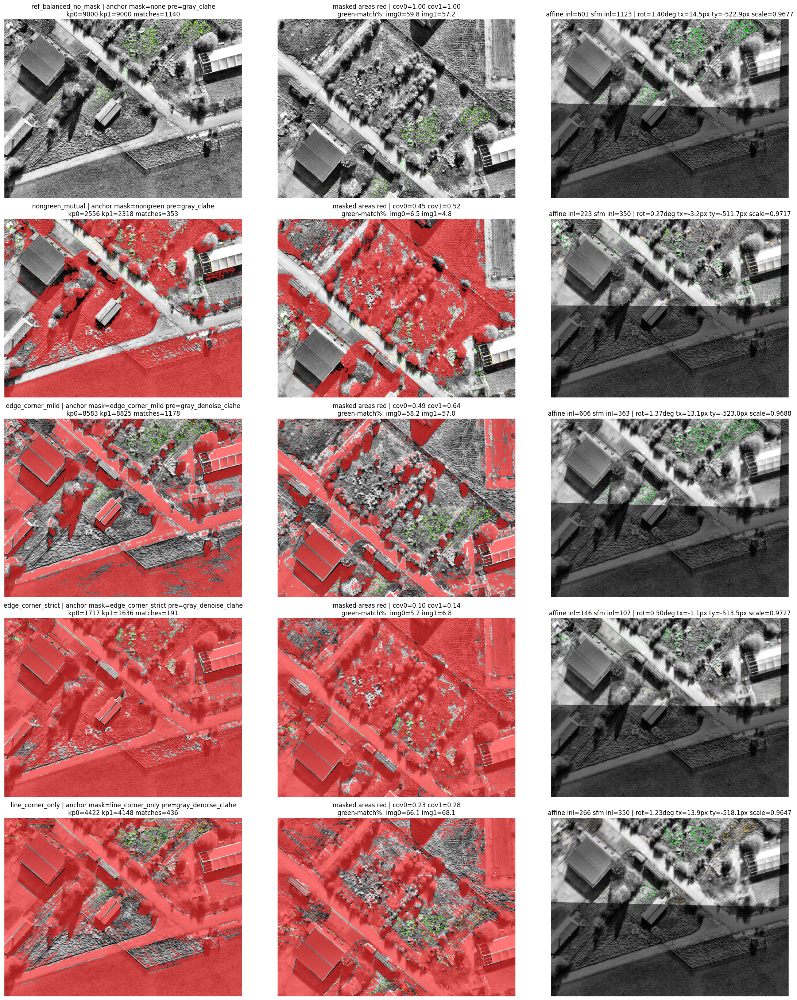

,variant,preprocess,mask_profile,kp0,kp1,kp0_green_pct,kp1_green_pct,matches,match_green0_pct,match_green1_pct,...,sfm_t_dir_x,sfm_t_dir_y,sfm_t_dir_z,mask_cov0,mask_cov1,mask_fallback0,mask_fallback1,drop_resp,drop_size_ratio,focus_score
0,edge_corner_mild,gray_denoise_clahe,edge_corner_mild,8583,8825,64.441338,64.419263,1178,58.234295,56.960951,...,-0.494012,0.605936,-0.623533,0.493019,0.642799,0,0,0,2,592.176570
1,ref_balanced_no_mask,gray_clahe,none,9000,9000,66.577778,66.577778,1140,59.824561,57.192982,...,-0.006868,0.998954,-0.045203,1.000000,1.000000,0,0,0,0,586.957895
2,line_corner_only,gray_denoise_clahe,line_corner_only,4422,4148,69.018544,70.998071,436,66.055046,68.119266,...,-0.061379,-0.233637,-0.970385,0.227352,0.282739,0,0,0,5,249.899083
3,nongreen_mutual,gray_clahe,nongreen,2556,2318,10.289515,8.153581,353,6.515581,4.815864,...,0.018607,0.997289,0.071194,0.454709,0.515330,0,0,0,2,221.640227
4,edge_corner_strict,gray_denoise_clahe,edge_corner_strict,1717,1636,10.658125,7.946210,191,5.235602,6.806283,...,-0.002879,0.245934,0.969282,0.101879,0.141116,0,0,0,1,144.554974


Best focus variant: edge_corner_mild
focus_score=592.18 | affine_inliers=606 | match_green0_pct=58.2 | match_green1_pct=57.0
2D pose: rot=1.37deg tx=13.12px ty=-523.03px scale=0.9688


In [14]:
# Visualize focused variants + metrics table
if 'focused_results' not in globals() or len(focused_results) == 0:
    raise RuntimeError('Run focused variant sweep cell first.')

fig, axes = plt.subplots(len(focused_results), 3, figsize=(23, 5.5 * len(focused_results)))
if len(focused_results) == 1:
    axes = np.array([axes])

for i, res in enumerate(focused_results):
    visL, visM, visR = draw_focused_triplet(res, max_draw=FOCUS_MAX_DRAW_MATCHES)

    axes[i, 0].imshow(visL)
    axes[i, 0].axis('off')
    axes[i, 1].imshow(visM)
    axes[i, 1].axis('off')
    axes[i, 2].imshow(visR)
    axes[i, 2].axis('off')

    n = len(res.matches)
    inl_a = int(res.affine_inliers.sum()) if res.affine_inliers.size else 0
    inl_s = int(res.sfm_inliers.sum()) if res.sfm_inliers.size else 0

    gm0 = _pts_in_mask(res.green0, res.pts0)
    gm1 = _pts_in_mask(res.green1, res.pts1)
    mg0 = (100.0 * float(gm0.mean())) if n > 0 else np.nan
    mg1 = (100.0 * float(gm1.mean())) if n > 0 else np.nan

    axes[i, 0].set_title(
        f"{res.name} | anchor mask={res.mask_profile} pre={res.preprocess_mode}\n"
        f"kp0={len(res.keypoints0)} kp1={len(res.keypoints1)} matches={n}"
    )
    axes[i, 1].set_title(
        f"masked areas red | cov0={res.mask_diag0.get('mask_cov', np.nan):.2f} cov1={res.mask_diag1.get('mask_cov', np.nan):.2f}\n"
        f"green-match%: img0={mg0:.1f} img1={mg1:.1f}"
    )
    axes[i, 2].set_title(
        f"affine inl={inl_a} sfm inl={inl_s} | rot={res.affine_rotation_deg:.2f}deg "
        f"tx={res.affine_tx:.1f}px ty={res.affine_ty:.1f}px scale={res.affine_scale:.4f}"
    )

plt.tight_layout()
plt.show()

focus_rows = [summarize_focused_result(r) for r in focused_results]
focus_metrics_df = pd.DataFrame(focus_rows)
focus_metrics_df = focus_metrics_df.sort_values(
    ['focus_score', 'affine_inliers', 'matches'],
    ascending=[False, False, False],
).reset_index(drop=True)

display(focus_metrics_df)

best_focus = focus_metrics_df.iloc[0]
print('Best focus variant:', best_focus['variant'])
print(
    f"focus_score={best_focus['focus_score']:.2f} | "
    f"affine_inliers={int(best_focus['affine_inliers'])} | "
    f"match_green0_pct={best_focus['match_green0_pct']:.1f} | "
    f"match_green1_pct={best_focus['match_green1_pct']:.1f}"
)
print(
    f"2D pose: rot={best_focus['affine_rot_deg']:.2f}deg "
    f"tx={best_focus['affine_tx_px']:.2f}px ty={best_focus['affine_ty_px']:.2f}px "
    f"scale={best_focus['affine_scale']:.4f}"
)


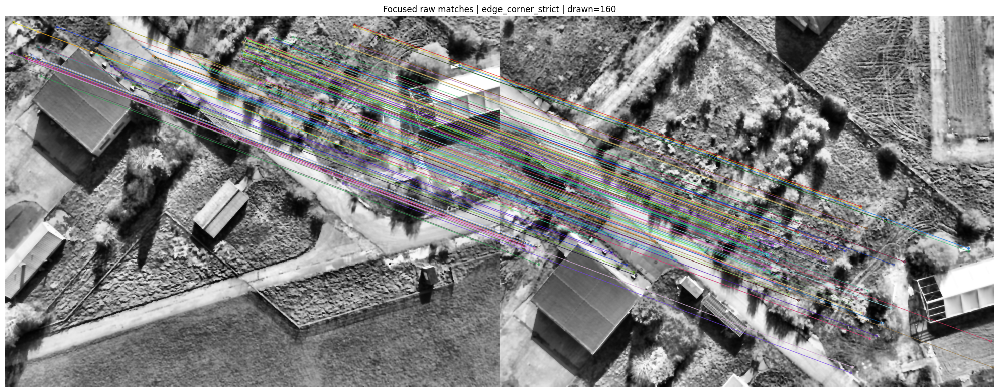

In [15]:
# Optional: raw match lines for focused variant (notebook-1 style)
FOCUS_SELECT_VARIANT = 'edge_corner_strict'
FOCUS_MAX_LINE_MATCHES = 160

cand = [r for r in focused_results if r.name == FOCUS_SELECT_VARIANT]
if len(cand) == 0:
    sel = focused_results[0]
    print(f'Variant {FOCUS_SELECT_VARIANT} not found. Using {sel.name}.')
else:
    sel = cand[0]

n = len(sel.matches)
idx = np.arange(n, dtype=np.int32)
inl = sel.affine_inliers if sel.affine_inliers.shape[0] == n else np.zeros((n,), dtype=bool)
if idx.size > FOCUS_MAX_LINE_MATCHES:
    inl_idx = np.where(inl)[0]
    out_idx = np.where(~inl)[0]
    need = int(FOCUS_MAX_LINE_MATCHES)
    if inl_idx.size >= need:
        idx = inl_idx[:need]
    else:
        idx = np.concatenate([inl_idx, out_idx[:need - inl_idx.size]])

vis0 = cv2.cvtColor(_ensure_gray_u8(sel.gray0), cv2.COLOR_GRAY2BGR)
vis1 = cv2.cvtColor(_ensure_gray_u8(sel.gray1), cv2.COLOR_GRAY2BGR)
draw_matches = [sel.matches[int(i)] for i in idx]
match_img = cv2.drawMatches(
    vis0,
    sel.keypoints0,
    vis1,
    sel.keypoints1,
    draw_matches,
    None,
    flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS,
)

plt.figure(figsize=(20, 8))
plt.imshow(cv2.cvtColor(match_img, cv2.COLOR_BGR2RGB))
plt.title(f"Focused raw matches | {sel.name} | drawn={len(draw_matches)}")
plt.axis('off')
plt.tight_layout()
plt.show()
